In [1]:
import pandas as pd
import numpy as np
import random
import string
import matplotlib.pyplot as plt 
import regex as re
from joblib import Memory
from scipy import sparse
from scipy.sparse import csr_matrix
from nltk.stem import PorterStemmer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.pipeline import Pipeline
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.metrics.pairwise import linear_kernel
from nltk.corpus import stopwords
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk import word_tokenize 
from scipy.sparse.linalg import svds

In [2]:
# pd.options.display.max_rows =2600 #dispaly the whole grid

In [3]:
pd.options.display.max_columns =9999 #dispaly the whole grid
# function to read csv file

def read (name):
    return pd.read_csv('./datasets/'+ name + '.csv')

# Datasets
Goodreads datasets consists of a few parts:<br>
a.books.csv: information of the books such as book id, book title and averaga rating of book<br>

In [4]:
book_all = read('books')
book_all.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 23 columns):
book_id                      10000 non-null int64
goodreads_book_id            10000 non-null int64
best_book_id                 10000 non-null int64
work_id                      10000 non-null int64
books_count                  10000 non-null int64
isbn                         9300 non-null object
isbn13                       9415 non-null float64
authors                      10000 non-null object
original_publication_year    9979 non-null float64
original_title               9415 non-null object
title                        10000 non-null object
language_code                8916 non-null object
average_rating               10000 non-null float64
ratings_count                10000 non-null int64
work_ratings_count           10000 non-null int64
work_text_reviews_count      10000 non-null int64
ratings_1                    10000 non-null int64
ratings_2                    10000 n

b.rating.csv: information regarding the rate given by users on the books <br>

In [5]:
read('ratings').info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5976479 entries, 0 to 5976478
Data columns (total 3 columns):
user_id    int64
book_id    int64
rating     int64
dtypes: int64(3)
memory usage: 136.8 MB


c.book_tags.csv and tags.csv: information of tags made by users on the books<br>

In [6]:
read('book_tags').info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999912 entries, 0 to 999911
Data columns (total 3 columns):
goodreads_book_id    999912 non-null int64
tag_id               999912 non-null int64
count                999912 non-null int64
dtypes: int64(3)
memory usage: 22.9 MB


In [7]:
read('tags').info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34252 entries, 0 to 34251
Data columns (total 2 columns):
tag_id      34252 non-null int64
tag_name    34252 non-null object
dtypes: int64(1), object(1)
memory usage: 535.3+ KB


d.to_read.csv: books that users planned to read

In [8]:
read('to_read').info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 912705 entries, 0 to 912704
Data columns (total 2 columns):
user_id    912705 non-null int64
book_id    912705 non-null int64
dtypes: int64(2)
memory usage: 13.9 MB


# Data Overview

In [9]:
rating = read('ratings')

In [10]:
rating.shape[1]

3

In [11]:
# Remove any possible duplicates row

rating.drop_duplicates(inplace=True)
print('We have',rating.shape[0], 'ratings.')
print('The number of unique users:', len(rating.user_id.unique()), '.')
print('The number of unique books:', len(rating.book_id.unique()),'.')
print('The median user rated %d books.'%rating.user_id.value_counts().median())
print('The max rating is: %d'%rating.rating.max(),' and the min rating is: %d'%rating.rating.min(), '.')

We have 5976479 ratings.
The number of unique users: 53424 .
The number of unique books: 10000 .
The median user rated 111 books.
The max rating is: 5  and the min rating is: 1 .


Text(0,0.5,'Number of ratings')

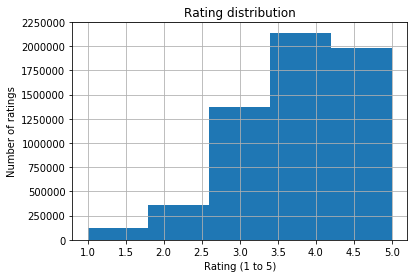

In [12]:
# check the distribution of ratings

rating.rating.hist(bins=5)
plt.title('Rating distribution')
plt.xlabel('Rating (1 to 5)')
plt.ylabel('Number of ratings')

In general, 4 is the most popular rating while 1 and 2 are the minority.<br>
Then, we look into the number of rating given into books.

In [13]:
# form a df for number of rating given per book

review_count = pd.DataFrame(rating.groupby('book_id').size(), columns=['count'])
review_count.head(3)

,count
book_id,
1,22806
2,21850
3,16931


Text(0.5,0,'Number of books')

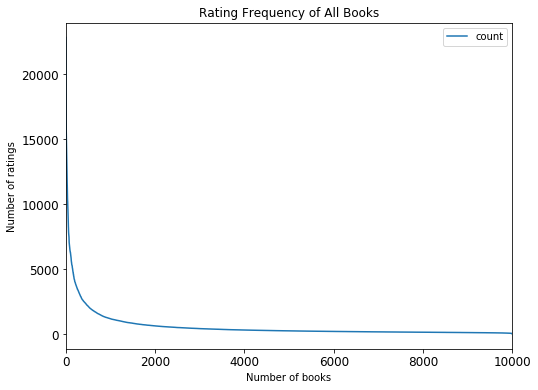

In [14]:
#form a graph using review_count

ax = review_count \
    .sort_values('count', ascending=False) \
    .reset_index(drop=True) \
    .plot(
        figsize=(8, 6),
        title='Rating Frequency of All Books',
        fontsize=12
    )

ax.set_ylabel('Number of ratings')
ax.set_xlabel('Number of books')

The graph follows a long-tail property pattern in which only a small fraction of items(popular books) are rated frequently. This causes in a highly skewed distribution of the underlying ratings. <br><br>
Then, we plot the same graph using log scale.

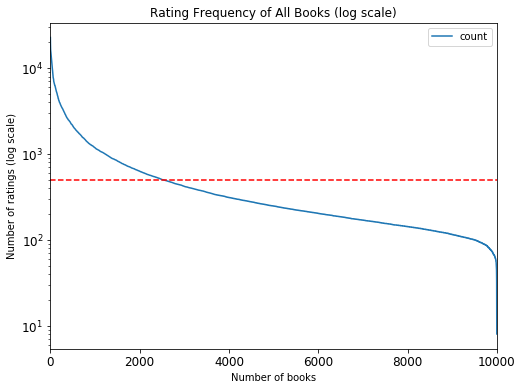

In [15]:
ax = review_count \
    .sort_values('count', ascending=False) \
    .reset_index(drop=True) \
    .plot(
        figsize=(8, 6),
        title='Rating Frequency of All Books (log scale)',
        fontsize=12,
        logy=True
)
ax.set_ylabel('Number of ratings (log scale)')
ax.set_xlabel('Number of books')
plt.axhline(y=500, color='r', linestyle='--', label='threshold')

We can observe that most of the books are rated in between 100 to 1000 times.<br>
The number of books is too large to be used in  building a model and might causes memory problem. Thus, we will only select the books with high number of rating. 

In [16]:
review_count.describe()

,count
count,10000.000000
mean,597.647900
std,1267.289788
min,8.000000
25%,155.000000
50%,248.000000
75%,503.000000
max,22806.000000


We set the threshold as 500, which is approximately top 25% in the number of rating. 

In [17]:
# set the filter criteria and select the data
threshold = 500
popular_list = list(set(review_count.query('count >= @threshold').index))
popular_book = rating[rating.book_id.isin(popular_list)]
print('Shape of original ratings data: ', rating.shape)
print('Shape of ratings data after dropping unpopular books: ', popular_book.shape)

Shape of original ratings data:  (5976479, 3)
Shape of ratings data after dropping unpopular books:  (4329108, 3)


The datasets is still considerable large. We need to further reduce it by zooming into number of rating made by each users.

In [18]:
# Review per user

reviews_per_user = pd.DataFrame(rating.groupby('user_id').size(), columns=['count'])
reviews_per_user.head(3)

,count
user_id,
1,117
2,65
3,91


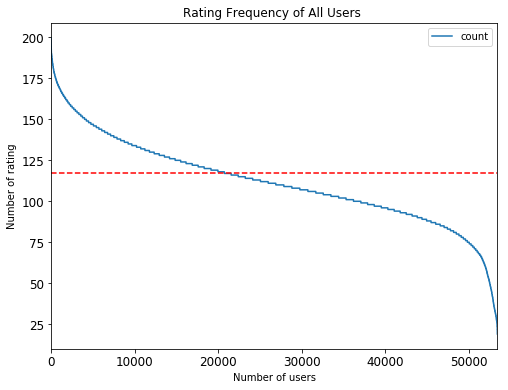

In [19]:
ax = reviews_per_user \
    .sort_values('count', ascending=False) \
    .reset_index(drop=True) \
    .plot(
        figsize=(8, 6),
        title='Rating Frequency of All Users ',
        fontsize=12,
)
ax.set_ylabel('Number of rating')
ax.set_xlabel('Number of users')
plt.axhline(y=117, color='r', linestyle='--', label='threshold')

In [20]:
reviews_per_user['count'].quantile(np.arange(1, 0, -0.05))

1.00    200.0
0.95    157.0
0.90    146.0
0.85    138.0
0.80    133.0
0.75    128.0
0.70    124.0
0.65    120.0
0.60    117.0
0.55    114.0
0.50    111.0
0.45    108.0
0.40    105.0
0.35    102.0
0.30     99.0
0.25     96.0
0.20     92.0
0.15     88.0
0.10     82.0
0.05     71.0
Name: count, dtype: float64

We only select users who rated at least 117 books (top 40%).

In [21]:
# set the filter criteria and select the data
threshold = 117
active_list = list(set(reviews_per_user.query('count >= @threshold').index))
book_df = popular_book[popular_book.user_id.isin(active_list)]
print('Shape of popular book data: ', popular_book.shape)
print('Shape of ratings data with popular books and active users: ', book_df.shape)
print('Amount of popular books:', len(book_df.book_id.unique()))
print('Number of active users:', len(book_df.user_id.unique()))

Shape of popular book data:  (4329108, 3)
Shape of ratings data with popular books and active users:  (2249118, 3)
Amount of popular books: 2526
Number of active users: 21557


**Book_df consists of 2526 books and 21557 users.**

In [22]:
book_df.head()

,user_id,book_id,rating
0,1,258,5
12,4,70,4
13,4,264,3
14,4,388,4
15,4,18,5


In [23]:
book_df.to_csv('./datasets/book_df.csv',index=False)

In [24]:
book_df.describe()

,user_id,book_id,rating
count,2.249118e+06,2.249118e+06,2.249118e+06
mean,2.456944e+04,7.215097e+02,3.893239e+00
std,1.524617e+04,7.771450e+02,1.000304e+00
min,1.000000e+00,1.000000e+00,1.000000e+00
25%,1.117500e+04,1.190000e+02,3.000000e+00
50%,2.352800e+04,4.160000e+02,4.000000e+00
75%,3.741700e+04,1.103000e+03,5.000000e+00
max,5.342400e+04,3.948000e+03,5.000000e+00


# Evaluation 
Evaluation helps us in determine the most suitable algorithms and hyperparameters for a model.<br>
In this model, We will split the data randomly into train and test set with a ratio of 4:1. <br><br>
The evaluation of metrics are computed using test data with either of the methods <br>
1.Top-N accuracy metrics<br>
2.MAP(mean average precision)<br>
2.NDCG(Normalized Discounted Cumulative Gain)<br>

More information about the methods can be found on this [post.](http://fastml.com/evaluating-recommender-systems/)<br><br>
In this model, we will use Top-N accuracy metric with **Recall@N** which evaluates whether the recommended book is among the top N items (hit) in the ranked list of 101 recommendations for a user.  

In [25]:
# Split the data into train and test set
train, test = train_test_split(book_df, test_size=0.20, stratify= book_df['user_id'], random_state=18)

print('Number of row in Train set:', len(train))
print('Number of row in Test set:', len(test))

Number of row in Train set: 1799294
Number of row in Test set: 449824


In [26]:
train.head()

,user_id,book_id,rating
3686735,24312,105,3
5841043,9131,2392,4
1425742,5891,1151,5
41742,1456,76,5
104324,3061,7,4


In [27]:
train.to_csv('./datasets/train.csv', index=False)
test.to_csv('./datasets/test.csv',index=False)

In [28]:
# Set user_id as index, will be easier for data searching
book_df_index = book_df.set_index('user_id')
test_index = test.set_index('user_id')
train_index = train.set_index('user_id')

In [29]:
# return a set of books based on the user_id
def get_read_books(user_id, data_index):
    
    books = data_index.loc[user_id]['book_id']
    # the function set is to prevent duplicate
    return set(books if type(books) == pd.Series else [books])


In [30]:
#Top-N accuracy metrics consts
# checking current read book ranking in the recommeded books
random_sample_nvr_read = 100

class ModelEvaluator:

    # find interacted items and find no interacted items then minus each other and sample the result
    def  get_nvr_read_sample(self, user_id, sample_size, seed=10):
        read_books = get_read_books(user_id, book_df_index)       # the read book function is defined on top
        all_books = set(book_df['book_id'])                     # set to ensure no duplicate 
        nvr_read_books = all_books - read_books

        # sample the items
        random.seed(seed)
        nvr_read_books_sample = random.sample(nvr_read_books, sample_size)
        return set(nvr_read_books_sample)


    # get 1 if the recommended books is in top n, else 0
    # also get the rank of the recommended items
    def _verify_hit_top_n(self, user_id, recommended_books, topn):        
           
            # next function will produce -1 after iterate all of the items in a list
            # get the index(rank)
            try:
                index = next(i for i, c in enumerate(recommended_books) if c == user_id)
                
            except:
                index = -1
            
            hit = int(index in range(0, topn))   # will return boolean, so use int to convert to 1 or 0
    
            return hit, index

    
    def evaluate_model_for_user(self, model, user_id):
        # Get the dataframe for that user_id
        test_user_df = test_index.loc[user_id]
        
        # Get all the book_id for that person_id in test set
        if type(test_user_df['book_id']) == pd.Series:
            test_books_id = set(test_user_df['book_id'])
        else:
            test_books_id = set([int(test_user_df['book_id'])])
        
        # Get the number of books read by that user_id in testset
        test_books_count = len(test_books_id) 

        # Get a ranked recommendation list from a model for a given user
        user_recs_df = model.recommend_books(user_id, 
                                             books_to_ignore=get_read_books(user_id, train_index), 
                                             topn=10000000000) #

        hits_at_5_count = 0
        hits_at_10_count = 0
       
        # For each book the user has read in test set
        for book_id in test_books_id:
            # Getting a random sample (100) books the user has not interacted 
            # (to represent books that are assumed to be no relevant to the user)
            nvr_read_book_sample = self.get_nvr_read_sample(user_id, 
                                                            sample_size=random_sample_nvr_read, 
                                                            seed=user_id)

         
            # Combining the current interacted item with the 100 random items
            books_to_filter_recs = nvr_read_book_sample.union(set([book_id])) #book_id is from the test_books_id

            # Filtering only recommendations that are either the read book or from a random sample of 100 never read books
            valid_recs_df = user_recs_df[user_recs_df['book_id'].isin(books_to_filter_recs)]                    
            valid_recs = valid_recs_df['book_id'].values
           
            # Verifying if the current read book is among the Top-N recommended books
            hit_at_5, index_at_5 = self._verify_hit_top_n(book_id, valid_recs, 5) #item_id is from the person_interacted_items_testset
            hits_at_5_count += hit_at_5
            hit_at_10, index_at_10 = self._verify_hit_top_n(book_id, valid_recs, 10)
            hits_at_10_count += hit_at_10
           
        # Recall is the rate of the interacted items that are ranked among the Top-N recommended items, 
        # when mixed with a set of non-relevant items
        recall_at_5 = hits_at_5_count / float(test_books_count)
        recall_at_10 = hits_at_10_count / float(test_books_count)

        person_metrics = {'hits@5_count':hits_at_5_count, 
                          'hits@10_count':hits_at_10_count, 
                          'books_count': test_books_count,
                          'recall@5': recall_at_5,
                          'recall@10': recall_at_10}
        
        return person_metrics

    def evaluate_model(self, model):
        #print('Running evaluation for users')
        people_metrics = []
        count=0
        # idx will get the running number like normal index, user_id will be all the users in the testset
        # .index.unique().values prevents repeated id and access the value of index which is user_id
        for idx, user_id in enumerate(list(test_index.index.unique().values)):
            #if idx % 100 == 0 and idx > 0:
            #    print('%d users processed' % idx)
            person_metrics = self.evaluate_model_for_user(model, user_id)
            count+=1
            if count%500==0:
                print(count, 'users processed')
#                 print(person_metrics)
            person_metrics['_user_id'] = user_id # got use??
            people_metrics.append(person_metrics)
        print('%d users processed' % idx)
        
        # convert people_metrics in dataframe format
        detailed_results_df = pd.DataFrame(people_metrics) \
                            .sort_values('books_count', ascending=False)
        
        global_recall_at_5 = detailed_results_df['hits@5_count'].sum() / float(detailed_results_df['books_count'].sum())
        global_recall_at_10 = detailed_results_df['hits@10_count'].sum() / float(detailed_results_df['books_count'].sum())
        
        global_metrics = {'modelName': model.get_model_name(),
                          'recall@5': global_recall_at_5,
                          'recall@10': global_recall_at_10}    
        return global_metrics, detailed_results_df
    
model_evaluator = ModelEvaluator() #instance for the class

In [31]:
train.head()

,user_id,book_id,rating
3686735,24312,105,3
5841043,9131,2392,4
1425742,5891,1151,5
41742,1456,76,5
104324,3061,7,4


# Collaborative filtering Model
### Matrix Factorization

In [32]:
# train[['user_id']].to_string

In [33]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1799294 entries, 3686735 to 3149576
Data columns (total 3 columns):
user_id    int64
book_id    int64
rating     int64
dtypes: int64(3)
memory usage: 54.9 MB


In [34]:
# Creating a pivot table with user_id in rows and book_id in columns
# using train data because we need to evaluate the model
book_pivot = train.pivot(index='user_id', columns='book_id', values='rating').fillna(0)

In [122]:
book_pivot.T.shape

(2526, 21557)

In [38]:
book_matrix.shape

(21557, 2526)

In [39]:
book_matrix[:10]

array([[0., 0., 0., ..., 0., 3., 0.],
       [0., 5., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [3., 0., 3., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 3., 0., ..., 0., 0., 0.]])

In [40]:
# number of factor to be used in matrix factorization
number_f = 50

# decompose the original matrix using svds and get the U matrix, Sigma matrix and Transpose of V matrix
U, sigma, Vt = svds(book_matrix, k= number_f)

In [41]:
print(U.shape)
print(sigma.shape)
print(Vt.shape)

(21557, 50)
(50,)
(50, 2526)


In [42]:
sigma = np.diag(sigma) 
sigma.shape

(50, 50)

We can reconstruct the original matrix by using the dot product of its factors and convert it back to dataframe.

In [43]:
predicted_ratings = np.dot(np.dot(U, sigma), Vt) 

In [44]:
# will be use for index assignment later 
user_id = list(book_pivot.index)

In [45]:
# tranpose make it easier to locate using user_id
cf_preds_df = pd.DataFrame(predicted_ratings, columns = book_pivot.columns, index=user_id).transpose() 

In [46]:
cf_preds_df.head()

,1,4,7,9,10,11,19,22,23,24,27,28,31,32,35,36,40,41,44,46,47,49,54,55,60,61,75,79,82,88,89,93,95,96,104,105,107,109,111,116,119,124,130,133,140,143,145,146,148,153,158,164,173,178,179,193,194,195,202,203,204,206,207,208,209,213,215,217,218,219,220,222,223,224,226,228,229,230,232,233,237,242,244,246,247,248,251,252,253,256,262,263,268,272,274,275,276,277,279,280,282,284,289,290,291,294,303,306,307,310,311,314,315,319,320,321,323,324,325,329,332,335,336,338,341,342,343,345,346,349,351,352,356,358,360,361,362,363,365,366,367,368,370,372,375,376,377,378,381,383,385,387,389,393,394,395,396,398,400,402,403,405,407,409,412,413,416,419,420,421,422,424,425,426,429,430,431,432,439,440,441,443,446,447,450,451,452,453,454,456,458,459,460,461,462,463,466,467,468,472,476,479,483,484,487,488,490,491,493,494,498,499,502,510,512,513,519,520,526,528,529,531,532,534,536,537,540,541,542,547,550,553,554,557,559,564,566,567,568,571,573,574,575,577,578,588,589,591,592,597,602,606,609,610,611,612,613,614,615,618,624,625,630,631,633,635,636,642,643,646,647,648,652,653,655,656,657,659,660,663,669,672,673,676,683,684,685,690,694,695,697,698,701,703,706,710,712,715,717,725,726,728,732,735,736,739,742,745,748,750,752,755,756,759,762,763,766,767,768,769,770,772,774,778,780,786,787,789,793,794,795,797,799,801,803,806,809,811,812,814,815,816,817,818,819,820,824,825,826,827,828,830,833,835,836,840,841,848,849,850,851,852,854,856,857,858,859,860,869,871,873,874,876,877,880,882,883,884,889,892,893,895,900,901,904,905,907,908,909,914,918,919,922,923,924,925,926,929,931,934,935,937,939,942,943,946,947,948,949,951,954,958,961,962,963,965,969,973,974,975,978,979,980,984,986,992,994,996,997,1002,1005,1008,1010,1013,1014,1017,1019,1022,1024,1026,1027,1030,1031,1035,1037,1038,1041,1042,1044,1046,1051,1052,1053,1057,1058,1059,1060,1061,1063,1064,1068,1072,1074,1075,1076,1077,1078,1081,1084,1088,1090,1092,1093,1095,1096,1097,1098,1104,1106,1107,1108,1109,1113,1115,1119,1120,1121,1123,1126,1127,1130,1136,1138,1143,1144,1145,1146,1148,1159,1160,1164,1166,1167,1169,1171,1173,1175,1178,1179,1180,1182,1183,1184,1185,1186,1187,1189,1192,1193,1195,1197,1198,1203,1206,1207,1208,1209,1212,1214,1216,1218,1221,1225,1228,1229,1234,1235,1237,1241,1244,1245,1247,1252,1255,1256,1260,1261,1263,1266,1267,1275,1276,1277,1278,1279,1280,1283,1284,1285,1286,1289,1290,1291,1294,1296,1298,1299,1300,1302,1303,1305,1307,1309,1311,1314,1317,1318,1320,1321,1322,1323,1325,1326,1327,1328,1334,1335,1339,1340,1341,1342,1344,1346,1347,1350,1352,1353,1354,1355,1357,1358,1359,1369,1370,1374,1376,1377,1379,1381,1383,1385,1386,1388,1391,1392,1393,1394,1395,1397,1399,1401,1402,1403,1404,1407,1408,1409,1411,1413,1415,1417,1419,1420,1421,1422,1423,1424,1428,1429,1430,1431,1433,1435,1438,1440,1445,1448,1449,1451,1453,1455,1456,1458,1459,1461,1464,1465,1468,1471,1474,1476,1477,1478,1479,1480,1481,1484,1485,1487,1489,1490,1491,1493,1497,1502,1503,1504,1507,1508,1510,1512,1515,1516,1518,1519,1521,1522,1524,1526,1527,1528,1529,1530,1532,1533,1536,1537,1538,1539,1541,1542,1544,1545,1546,1547,1549,1553,1554,1556,1557,1558,1560,1561,1564,1565,1566,1567,1568,1570,1571,1572,1573,1576,1578,1580,1581,1582,1583,1585,1586,1589,1590,1593,1594,1595,1597,1599,1600,1601,1603,1608,1609,1610,1611,1612,1613,1614,1618,1619,1620,1624,1631,1634,1639,1643,1644,1645,1651,1655,1656,1657,1660,1661,1663,1664,1665,1666,1669,1671,1672,1673,1675,1677,1678,1681,1682,1683,1688,1689,1693,1697,1702,1703,1706,1709,1710,1711,1712,1713,1714,1715,1717,1719,1720,1721,1722,1724,1729,1732,1733,1734,1737,1738,1739,1741,1746,1747,1748,1750,1753,1756,1757,1758,1759,1761,1762,1763,1764,1766,1767,1772,1775,1779,1780,1781,1782,1784,1785,1786,1789,1790,1792,1794,1795,1797,1799,1800,1806,1807,1809,1810,1812,1813,1814,1816,1821,1822,1824,1825,1826,1827,1829,1830,1831,1835,1836,1837,1838,1844,1845,1848,1850,1851,1852,1853,1855,1856,1859,1860,1862,1863,1865,1866,1868,1873,1874,1875,1877,1878,1880,1883,1884,1885,1887,1889,1890,1891,1892,1893,1895,1896,1902,1908,1

In [47]:
# user_id = 1 then its predicted result 
cf_preds_df[1].head()

book_id
1    0.352589
2   -0.156051
3    0.407750
4    4.968788
5    0.491136
Name: 1, dtype: float64

In [48]:
class CFRecommender:
    
    MODEL_NAME = 'Collaborative Filtering'
        
    def __init__(self, cf_predictions_df, books_df=None):
        self.cf_predictions_df = cf_predictions_df
        self.books_df = books_df
        
    def get_model_name(self):
        return self.MODEL_NAME
        
    def recommend_books(self, user_id, books_to_ignore=[], topn=10, verbose=False):
        # Get and sort the user's predictions from previous step
        sorted_user_predictions = self.cf_predictions_df[user_id].sort_values(ascending=False)\
                                   .reset_index().rename(columns={user_id: 'rating'})

        
        
        # Recommend the highest predicted rating books that the user hasn't read yet, '~' means NOT 
        # book_to_ignore will be needed when calling this function 
        recommendations_df = sorted_user_predictions[~sorted_user_predictions['book_id'].isin(books_to_ignore)] \
                               .sort_values('rating', ascending = False) \
                               .head(topn)

        return recommendations_df
    
cf_recommender_model = CFRecommender(cf_preds_df, book_df)

In [49]:
cf_recommender_model.recommend_books(1, topn=10, verbose=True)

,book_id,rating
0,11,5.086868
1,4,4.968788
2,33,4.028224
3,16,3.598723
4,10,3.466505
5,67,3.319164
6,31,3.124147
7,47,3.061756
8,45,2.916989
9,57,2.851324


### Store function result 

In [50]:
# create a location to store the cache
location = './cachedir2'
memory = Memory(location, verbose=0)

In [51]:
model_evaluator.evaluate_model = memory.cache(model_evaluator.evaluate_model)

In [52]:
model_evaluator.evaluate_model(cf_recommender_model)

({'modelName': 'Collaborative Filtering',
  'recall@5': 0.562911271964146,
  'recall@10': 0.7087816568257808},
        _user_id  books_count  hits@10_count  hits@5_count  recall@10  recall@5
 12346     12381           39             33            28   0.846154  0.717949
 6754      39703           39             29            22   0.743590  0.564103
 4778      52036           39             27            25   0.692308  0.641026
 5483      30944           39             26            21   0.666667  0.538462
 2859      45554           39             29            25   0.743590  0.641026
 4828       6342           38             34            31   0.894737  0.815789
 5339      33065           38             31            28   0.815789  0.736842
 5262      38798           38             28            25   0.736842  0.657895
 9234      14372           38             27            15   0.710526  0.394737
 3610      32055           37             28            22   0.756757  0.594595
 5704    

In [53]:
print('Evaluating Collaborative Filtering (SVD Matrix Factorization) model...')
cf_global_metrics, cf_detailed_results_df = model_evaluator.evaluate_model(cf_recommender_model)
print('\nGlobal metrics:\n%s' % cf_global_metrics)
cf_detailed_results_df.head(10)

Evaluating Collaborative Filtering (SVD Matrix Factorization) model...

Global metrics:
{'modelName': 'Collaborative Filtering', 'recall@5': 0.562911271964146, 'recall@10': 0.7087816568257808}


,_user_id,books_count,hits@10_count,hits@5_count,recall@10,recall@5
12346,12381,39,33,28,0.846154,0.717949
6754,39703,39,29,22,0.743590,0.564103
4778,52036,39,27,25,0.692308,0.641026
5483,30944,39,26,21,0.666667,0.538462
2859,45554,39,29,25,0.743590,0.641026
4828,6342,38,34,31,0.894737,0.815789
5339,33065,38,31,28,0.815789,0.736842
5262,38798,38,28,25,0.736842,0.657895
9234,14372,38,27,15,0.710526,0.394737
3610,32055,37,28,22,0.756757,0.594595


### The predicted_ratings above is used for evaluation. We need to recalculate the predicted_ratings using the whole train plus test set. <br>



In [54]:
book_df.user_id = book_df.user_id.astype(int)

/Users/chowmun/anaconda3/lib/python3.6/site-packages/pandas/core/generic.py:5096: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


In [55]:
book_info = pd.read_csv('./datasets/book_info.csv')

In [56]:
# only keep 2 books for each author
book_info_unique = book_info.groupby('authors').head(2)

In [57]:
book_info_unique = book_info_unique.drop([3], axis=0)

In [58]:
len(book_info_unique)

1655

In [59]:
z = book_info[book_info.book_id.isin(book_info_unique.book_id)]

In [60]:
book_info_unique = z.book_id

In [61]:
pd.DataFrame(book_info_unique).to_csv('./datasets/book_info_unique.csv')

In [62]:
len(book_df.groupby('user_id'))

21557

In [63]:
book_pivot2 = book_df.pivot(index='user_id', columns='book_id', values='rating').fillna(0)
book_matrix2 = book_pivot2.as_matrix()
# number of factor to be used in matrix factorization
number_f = 50

# decompose the original matrix using svds and get the U matrix, Sigma matrix and Transpose of V matrix
U2, sigma2, Vt2 = svds(book_matrix2, k= number_f)
sigma2 = np.diag(sigma2) 

predicted_ratings2 = np.dot(np.dot(U2, sigma2), Vt2) 
user_id2 = list(book_pivot2.index)

/Users/chowmun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  


In [126]:
book_pivot2.T.head(10)

user_id,1,4,7,9,10,11,19,22,23,24,27,28,31,32,35,36,40,41,44,46,47,49,54,55,60,61,75,79,82,88,89,93,95,96,104,105,107,109,111,116,119,124,130,133,140,143,145,146,148,153,158,164,173,178,179,193,194,195,202,203,204,206,207,208,209,213,215,217,218,219,220,222,223,224,226,228,229,230,232,233,237,242,244,246,247,248,251,252,253,256,262,263,268,272,274,275,276,277,279,280,282,284,289,290,291,294,303,306,307,310,311,314,315,319,320,321,323,324,325,329,332,335,336,338,341,342,343,345,346,349,351,352,356,358,360,361,362,363,365,366,367,368,370,372,375,376,377,378,381,383,385,387,389,393,394,395,396,398,400,402,403,405,407,409,412,413,416,419,420,421,422,424,425,426,429,430,431,432,439,440,441,443,446,447,450,451,452,453,454,456,458,459,460,461,462,463,466,467,468,472,476,479,483,484,487,488,490,491,493,494,498,499,502,510,512,513,519,520,526,528,529,531,532,534,536,537,540,541,542,547,550,553,554,557,559,564,566,567,568,571,573,574,575,577,578,588,589,591,592,597,602,606,609,610,611,612,613,614,615,618,624,625,630,631,633,635,636,642,643,646,647,648,652,653,655,656,657,659,660,663,669,672,673,676,683,684,685,690,694,695,697,698,701,703,706,710,712,715,717,725,726,728,732,735,736,739,742,745,748,750,752,755,756,759,762,763,766,767,768,769,770,772,774,778,780,786,787,789,793,794,795,797,799,801,803,806,809,811,812,814,815,816,817,818,819,820,824,825,826,827,828,830,833,835,836,840,841,848,849,850,851,852,854,856,857,858,859,860,869,871,873,874,876,877,880,882,883,884,889,892,893,895,900,901,904,905,907,908,909,914,918,919,922,923,924,925,926,929,931,934,935,937,939,942,943,946,947,948,949,951,954,958,961,962,963,965,969,973,974,975,978,979,980,984,986,992,994,996,997,1002,1005,1008,1010,1013,1014,1017,1019,1022,1024,1026,1027,1030,1031,1035,1037,1038,1041,1042,1044,1046,1051,1052,1053,1057,1058,1059,1060,1061,1063,1064,1068,1072,1074,1075,1076,1077,1078,1081,1084,1088,1090,1092,1093,1095,1096,1097,1098,1104,1106,1107,1108,1109,1113,1115,1119,1120,1121,1123,1126,1127,1130,1136,1138,1143,1144,1145,1146,1148,1159,1160,1164,1166,1167,1169,1171,1173,1175,1178,1179,1180,1182,1183,1184,1185,1186,1187,1189,1192,1193,1195,1197,1198,1203,1206,1207,1208,1209,1212,1214,1216,1218,1221,1225,1228,1229,1234,1235,1237,1241,1244,1245,1247,1252,1255,1256,1260,1261,1263,1266,1267,1275,1276,1277,1278,1279,1280,1283,1284,1285,1286,1289,1290,1291,1294,1296,1298,1299,1300,1302,1303,1305,1307,1309,1311,1314,1317,1318,1320,1321,1322,1323,1325,1326,1327,1328,1334,1335,1339,1340,1341,1342,1344,1346,1347,1350,1352,1353,1354,1355,1357,1358,1359,1369,1370,1374,1376,1377,1379,1381,1383,1385,1386,1388,1391,1392,1393,1394,1395,1397,1399,1401,1402,1403,1404,1407,1408,1409,1411,1413,1415,1417,1419,1420,1421,1422,1423,1424,1428,1429,1430,1431,1433,1435,1438,1440,1445,1448,1449,1451,1453,1455,1456,1458,1459,1461,1464,1465,1468,1471,1474,1476,1477,1478,1479,1480,1481,1484,1485,1487,1489,1490,1491,1493,1497,1502,1503,1504,1507,1508,1510,1512,1515,1516,1518,1519,1521,1522,1524,1526,1527,1528,1529,1530,1532,1533,1536,1537,1538,1539,1541,1542,1544,1545,1546,1547,1549,1553,1554,1556,1557,1558,1560,1561,1564,1565,1566,1567,1568,1570,1571,1572,1573,1576,1578,1580,1581,1582,1583,1585,1586,1589,1590,1593,1594,1595,1597,1599,1600,1601,1603,1608,1609,1610,1611,1612,1613,1614,1618,1619,1620,1624,1631,1634,1639,1643,1644,1645,1651,1655,1656,1657,1660,1661,1663,1664,1665,1666,1669,1671,1672,1673,1675,1677,1678,1681,1682,1683,1688,1689,1693,1697,1702,1703,1706,1709,1710,1711,1712,1713,1714,1715,1717,1719,1720,1721,1722,1724,1729,1732,1733,1734,1737,1738,1739,1741,1746,1747,1748,1750,1753,1756,1757,1758,1759,1761,1762,1763,1764,1766,1767,1772,1775,1779,1780,1781,1782,1784,1785,1786,1789,1790,1792,1794,1795,1797,1799,1800,1806,1807,1809,1810,1812,1813,1814,1816,1821,1822,1824,1825,1826,1827,1829,1830,1831,1835,1836,1837,1838,1844,1845,1848,1850,1851,1852,1853,1855,1856,1859,1860,1862,1863,1865,1866,1868,1873,1874,1875,1877,1878,1880,1883,1884,1885,1887,1889,1890,1891,1892,1893,1895,1896,1902

In [64]:
# round to 2 decimal places and change to float32 for memory optimization
predicted_ratings2 = np.round(predicted_ratings2,2)
predicted_ratings2.astype(np.float32)

array([[ 0.51,  0.06,  0.33, ...,  0.04,  0.21, -0.13],
       [ 0.43,  4.82,  0.33, ...,  0.08,  0.01, -0.14],
       [-0.19,  0.67, -0.34, ...,  0.12,  0.05,  0.19],
       ...,
       [ 3.04,  4.3 ,  2.24, ...,  0.13, -0.09, -0.04],
       [ 5.17,  5.53,  1.12, ...,  0.06, -0.03,  0.26],
       [ 4.8 ,  4.2 ,  3.39, ...,  0.32, -0.01,  0.01]], dtype=float32)

In [65]:
cf_preds_df2 = pd.DataFrame(predicted_ratings2, columns = book_pivot2.columns, index=user_id2).transpose() 
cf_preds_df2.shape

(2526, 21557)

In [127]:
cf_preds_df2.head(10)

,1,4,7,9,10,11,19,22,23,24,27,28,31,32,35,36,40,41,44,46,47,49,54,55,60,61,75,79,82,88,89,93,95,96,104,105,107,109,111,116,119,124,130,133,140,143,145,146,148,153,158,164,173,178,179,193,194,195,202,203,204,206,207,208,209,213,215,217,218,219,220,222,223,224,226,228,229,230,232,233,237,242,244,246,247,248,251,252,253,256,262,263,268,272,274,275,276,277,279,280,282,284,289,290,291,294,303,306,307,310,311,314,315,319,320,321,323,324,325,329,332,335,336,338,341,342,343,345,346,349,351,352,356,358,360,361,362,363,365,366,367,368,370,372,375,376,377,378,381,383,385,387,389,393,394,395,396,398,400,402,403,405,407,409,412,413,416,419,420,421,422,424,425,426,429,430,431,432,439,440,441,443,446,447,450,451,452,453,454,456,458,459,460,461,462,463,466,467,468,472,476,479,483,484,487,488,490,491,493,494,498,499,502,510,512,513,519,520,526,528,529,531,532,534,536,537,540,541,542,547,550,553,554,557,559,564,566,567,568,571,573,574,575,577,578,588,589,591,592,597,602,606,609,610,611,612,613,614,615,618,624,625,630,631,633,635,636,642,643,646,647,648,652,653,655,656,657,659,660,663,669,672,673,676,683,684,685,690,694,695,697,698,701,703,706,710,712,715,717,725,726,728,732,735,736,739,742,745,748,750,752,755,756,759,762,763,766,767,768,769,770,772,774,778,780,786,787,789,793,794,795,797,799,801,803,806,809,811,812,814,815,816,817,818,819,820,824,825,826,827,828,830,833,835,836,840,841,848,849,850,851,852,854,856,857,858,859,860,869,871,873,874,876,877,880,882,883,884,889,892,893,895,900,901,904,905,907,908,909,914,918,919,922,923,924,925,926,929,931,934,935,937,939,942,943,946,947,948,949,951,954,958,961,962,963,965,969,973,974,975,978,979,980,984,986,992,994,996,997,1002,1005,1008,1010,1013,1014,1017,1019,1022,1024,1026,1027,1030,1031,1035,1037,1038,1041,1042,1044,1046,1051,1052,1053,1057,1058,1059,1060,1061,1063,1064,1068,1072,1074,1075,1076,1077,1078,1081,1084,1088,1090,1092,1093,1095,1096,1097,1098,1104,1106,1107,1108,1109,1113,1115,1119,1120,1121,1123,1126,1127,1130,1136,1138,1143,1144,1145,1146,1148,1159,1160,1164,1166,1167,1169,1171,1173,1175,1178,1179,1180,1182,1183,1184,1185,1186,1187,1189,1192,1193,1195,1197,1198,1203,1206,1207,1208,1209,1212,1214,1216,1218,1221,1225,1228,1229,1234,1235,1237,1241,1244,1245,1247,1252,1255,1256,1260,1261,1263,1266,1267,1275,1276,1277,1278,1279,1280,1283,1284,1285,1286,1289,1290,1291,1294,1296,1298,1299,1300,1302,1303,1305,1307,1309,1311,1314,1317,1318,1320,1321,1322,1323,1325,1326,1327,1328,1334,1335,1339,1340,1341,1342,1344,1346,1347,1350,1352,1353,1354,1355,1357,1358,1359,1369,1370,1374,1376,1377,1379,1381,1383,1385,1386,1388,1391,1392,1393,1394,1395,1397,1399,1401,1402,1403,1404,1407,1408,1409,1411,1413,1415,1417,1419,1420,1421,1422,1423,1424,1428,1429,1430,1431,1433,1435,1438,1440,1445,1448,1449,1451,1453,1455,1456,1458,1459,1461,1464,1465,1468,1471,1474,1476,1477,1478,1479,1480,1481,1484,1485,1487,1489,1490,1491,1493,1497,1502,1503,1504,1507,1508,1510,1512,1515,1516,1518,1519,1521,1522,1524,1526,1527,1528,1529,1530,1532,1533,1536,1537,1538,1539,1541,1542,1544,1545,1546,1547,1549,1553,1554,1556,1557,1558,1560,1561,1564,1565,1566,1567,1568,1570,1571,1572,1573,1576,1578,1580,1581,1582,1583,1585,1586,1589,1590,1593,1594,1595,1597,1599,1600,1601,1603,1608,1609,1610,1611,1612,1613,1614,1618,1619,1620,1624,1631,1634,1639,1643,1644,1645,1651,1655,1656,1657,1660,1661,1663,1664,1665,1666,1669,1671,1672,1673,1675,1677,1678,1681,1682,1683,1688,1689,1693,1697,1702,1703,1706,1709,1710,1711,1712,1713,1714,1715,1717,1719,1720,1721,1722,1724,1729,1732,1733,1734,1737,1738,1739,1741,1746,1747,1748,1750,1753,1756,1757,1758,1759,1761,1762,1763,1764,1766,1767,1772,1775,1779,1780,1781,1782,1784,1785,1786,1789,1790,1792,1794,1795,1797,1799,1800,1806,1807,1809,1810,1812,1813,1814,1816,1821,1822,1824,1825,1826,1827,1829,1830,1831,1835,1836,1837,1838,1844,1845,1848,1850,1851,1852,1853,1855,1856,1859,1860,1862,1863,1865,1866,1868,1873,1874,1875,1877,1878,1880,1883,1884,1885,1887,1889,1890,1891,1892,1893,1895,1896,1902,1908,1

In [66]:
# check the first and last number 
column_name = cf_preds_df2.columns
column_name

Int64Index([    1,     4,     7,     9,    10,    11,    19,    22,    23,
               24,
            ...
            53390, 53400, 53401, 53403, 53409, 53411, 53413, 53419, 53422,
            53424],
           dtype='int64', length=21557)

In [67]:
lower = 5000  
upper = 0
sub = [i for i in range(11)]
if lower < 55000:
    for i in range(11):
        sub[i] = [name for name in column_name if upper<=name<lower]
        upper += 5000
        lower += 5000
         

Loop and save the files

In [68]:
for i in range(11):
    cf_preds_df2[sub[i]].to_pickle('./datasets/cf_preds_df'+str(i)+'.pkl')

###  We will pick a few books  and let the new user to rate. The books are choosen in such a way they have a high number of review count and consist of different genres. We will use the same list for all the new users and the recommended books will not consists of the books to rate. 

In [69]:
# first criteria
criteria = review_count[review_count['count'] >=14000]

In [70]:
# get the book_id and extract the book information 
criteria = criteria.index

In [71]:
book_info = read('book_info')

In [72]:
book_info.head(2)

,goodreads_book_id,summary,genre,book_id,best_book_id,work_id,books_count,isbn,isbn13,authors,original_publication_year,original_title,title,language_code,average_rating,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,image_url,small_image_url
0,1,When Harry Potter and the Half-Blood Prince op...,"['Fantasy', 'Young Adult', 'Fiction']",27,1,41335427,275,439785960,9.780440e+12,"J.K. Rowling, Mary GrandPré",2005.0,Harry Potter and the Half-Blood Prince,Harry Potter and the Half-Blood Prince (Harry ...,eng,4.54,1678823,1785676,27520,7308,21516,136333,459028,1161491,https://images.gr-assets.com/books/1361039191m...,https://images.gr-assets.com/books/1361039191s...
1,2,There is a door at the end of a silent corrido...,"['Fantasy', 'Young Adult', 'Fiction']",21,2,2809203,307,439358078,9.780439e+12,"J.K. Rowling, Mary GrandPré",2003.0,Harry Potter and the Order of the Phoenix,Harry Potter and the Order of the Phoenix (Har...,eng,4.46,1735368,1840548,28685,9528,31577,180210,494427,1124806,https://images.gr-assets.com/books/1387141547m...,https://images.gr-assets.com/books/1387141547s...


In [73]:
# the genre is a long string and is not separated by ",", so we need to do regrex and split
# def convert(input):
#     return re.sub('[^A-Za-z0-9,]','',input).split(",")

In [74]:
# convert original_publication_year to int
book_info.original_publication_year = book_info.original_publication_year.fillna(0).astype(int)

In [75]:
# save the output
book_info.to_csv('./datasets/book_info.csv', index=False)

In [76]:
book_to_rate = book_info[book_info.book_id.isin(criteria)]


In [77]:
# remove those with same author to have more variety of choices
book_to_rate = book_to_rate[book_to_rate.book_id.isin([3,4,5,7,8,13,14,16,20,23])]
book_to_rate.to_csv('./datasets/book_to_rate.csv',index=False)

In [78]:
book_to_rate = pd.read_csv('./datasets/book_to_rate.csv')

In [79]:
len(book_to_rate)

10

# Pivot table for similar user

In [80]:
# constraint the book_id to the books that going to be rated by user
# which are 3,4,5,7,8,13,14,16,20,23

In [81]:
book_df_10books = book_df[book_df.book_id.isin([3,4,5,7,8,13,14,16,20,23])]

In [82]:
book_df_10books.to_csv('./datasets/book_df_10books.csv', index=False)

In [83]:
book_to_rate_id = [3,4,5,7,8,13,14,16,20,23]
user_rating = [int(i) for i in [1,1,1,1,1,1,1,1,1,1]]

In [84]:
# this 
book_pivot_10books = book_df_10books.pivot(index='user_id', columns='book_id', values='rating').fillna(0)


In [85]:
book_pivot_10books.head()

book_id,3,4,5,7,8,13,14,16,20,23
user_id,,,,,,,,,,
1,0.0,5.0,0.0,0.0,0.0,4.0,0.0,3.0,0.0,0.0
4,0.0,4.0,4.0,4.0,4.0,4.0,3.0,0.0,0.0,5.0
7,0.0,0.0,3.0,0.0,2.0,5.0,0.0,0.0,0.0,0.0
9,4.0,0.0,5.0,0.0,0.0,5.0,4.0,2.0,4.0,3.0
10,0.0,5.0,5.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0


In [86]:
# book_pivot_10books_sparse = csr_matrix(book_pivot_10books.values)

# example for testing purpose
# q = csr_matrix([3,1,2,2,1,2,2,2,2,4])

In [87]:
# cosine_sim = cosine_similarity(book_pivot_10books_sparse, q)
# similarity_scores = list(enumerate(cosine_sim))
# similarity_scores = sorted(similarity_scores, key=lambda x: x[1], reverse=True)
# similar_user = int(similarity_scores[0][0]) 

In [88]:
# similarity_scores = list(enumerate(cosine_sim))

In [89]:
# cosine_df = pd.DataFrame(cosine_sim, index=book_pivot_10books.index, columns=['cosine'])

In [90]:
# similar_user = cosine_df.sort_values(by='cosine', ascending=False).reset_index().loc[0, 'user_id']

In [91]:
def collab_recommender(rating_list):
    # get user input

    book_to_rate_id = [3,4,5,7,8,13,14,16,20,23]
    user_rating = [int(i) for i in rating_list] # change data type to int

    new_df = pd.DataFrame.from_dict({'book_id': book_to_rate_id,'rating': user_rating})
    new_df['user_id'] = 'new_user' # give a random user_id for new user
    new_df = new_df.pivot(index='user_id', columns='book_id', values='rating')
    new_df = csr_matrix(new_df.values)
    book_pivot_index = book_pivot_10books.set_index('user_id')
    book_pivot_10books_sparse = csr_matrix(book_pivot_index.values)
    # find similar user with the new user
    cosine_sim = cosine_similarity(book_pivot_10books_sparse, new_df)
    # form a dataframe using cosine_sim
    cosine_df = pd.DataFrame(cosine_sim, index=book_pivot_index.index, columns=['cosine'])
    similar_user = cosine_df.sort_values(by='cosine', ascending=False).reset_index().loc[0,'user_id']

    # recommend based on the similar user's preference
    user = int(similar_user/5000)
    cf_preds_df =  pd.read_pickle('./datasets/cf_preds_df'+str(user)+'.pkl')
    sorted_df = cf_preds_df[similar_user].sort_values(ascending=False)
    recommend_df = sorted_df[~sorted_df.index.isin(book_to_rate['book_id'])]
    del cf_preds_df
    recommend_df_unique = recommend_df[recommend_df.index.isin(book_info_unique.book_id)]#

    return book_info[book_info['book_id'].isin(recommend_df_unique.head(10).index)]

# Content Based Model

In [92]:
# Part_1 to 5 obtained from scrap_summary_genre.ipytn
book_info = pd.concat([read('part_1'), read('part_2'), read('part_3'), read('part_4'), read('part_5')])
book_info = book_info.drop(['Unnamed: 0'],axis=1)
book_info.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2526 entries, 0 to 504
Data columns (total 3 columns):
goodreads_book_id    2526 non-null int64
summary              2526 non-null object
genre                2526 non-null object
dtypes: int64(1), object(2)
memory usage: 78.9+ KB


The book_id and goodread_book_id are different. In order to prevent any confusion, we will only use goodread_book_id for web scrapping. Thus, we need to merge the book_id into the book_info. 

In [93]:
# form a dataframe for the selected book_id
selected_books = pd.DataFrame(book_df['book_id'].unique(), columns=['book_id'])
selected_books.head(2)

,book_id
0,258
1,70


In [94]:
# combine with 'book.csv' with only books that are filtered earlier
gdread = selected_books.merge(book_all, how='left', on='book_id')

In [95]:
# extract the goodread_id 
gdread_id = gdread.goodreads_book_id

In [96]:
book_info = book_info.merge(gdread)
book_info.head(3)

,goodreads_book_id,summary,genre,book_id,best_book_id,work_id,books_count,isbn,isbn13,authors,original_publication_year,original_title,title,language_code,average_rating,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,image_url,small_image_url
0,1,When Harry Potter and the Half-Blood Prince op...,"['Fantasy', 'Young Adult', 'Fiction']",27,1,41335427,275,439785960,9.780440e+12,"J.K. Rowling, Mary GrandPré",2005.0,Harry Potter and the Half-Blood Prince,Harry Potter and the Half-Blood Prince (Harry ...,eng,4.54,1678823,1785676,27520,7308,21516,136333,459028,1161491,https://images.gr-assets.com/books/1361039191m...,https://images.gr-assets.com/books/1361039191s...
1,2,There is a door at the end of a silent corrido...,"['Fantasy', 'Young Adult', 'Fiction']",21,2,2809203,307,439358078,9.780439e+12,"J.K. Rowling, Mary GrandPré",2003.0,Harry Potter and the Order of the Phoenix,Harry Potter and the Order of the Phoenix (Har...,eng,4.46,1735368,1840548,28685,9528,31577,180210,494427,1124806,https://images.gr-assets.com/books/1387141547m...,https://images.gr-assets.com/books/1387141547s...
2,3,Harry Potter's life is miserable. His parents ...,"['Fantasy', 'Young Adult', 'Fiction', 'Fantasy...",2,3,4640799,491,439554934,9.780440e+12,"J.K. Rowling, Mary GrandPré",1997.0,Harry Potter and the Philosopher's Stone,Harry Potter and the Sorcerer's Stone (Harry P...,eng,4.44,4602479,4800065,75867,75504,101676,455024,1156318,3011543,https://images.gr-assets.com/books/1474154022m...,https://images.gr-assets.com/books/1474154022s...


In [97]:
book_info.to_csv('./datasets/book_info.csv',index=False)

In [98]:
book_title_index = book_info.set_index('title')

In [99]:
# join the summary and genre to analyse them together 
book_info['text'] = book_info.summary + book_info.genre

# convert to a list so that it can be processed 
book_words = book_info.text.to_list()

In [100]:
# Add any other words to stop words and convert them to a set for a faster search
my_stops = stopwords.words('english')
my_stops.extend(['none','n', 'ye','com', 'isbn',"'d", "'ll", "'re", "'s", "'ve", 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'])
my_stops = set(my_stops)

In [101]:
class Stemmer(object):
    def __init__(self):
        self.stm = PorterStemmer()
    
    # in TfidfVectorizer, stop_words will only been removed after stemmer, 
    # so we must exclude those stop words before hand
    def __call__(self, doc):
        doc = re.sub("[^a-zA-Z0-9]", " ", doc)
        return [self.stm.stem(t) for t in word_tokenize(doc) if t not in my_stops]

In [102]:
pipe = Pipeline([
    ('vectorizer', TfidfVectorizer(
        analyzer='word',
        tokenizer=Stemmer(),
        strip_accents='unicode',
        ngram_range=(1, 2),
        stop_words=my_stops,
        max_features=4000,
        min_df=0.003,
        max_df=0.5,
    )),
    ('normalizer', StandardScaler(with_mean=False))
])

In [103]:
# fit into the model and get the feature
tfidf_matrix = pipe.fit_transform(book_words)

In [104]:
# need to call the pipeline to access the function
tfidf_features = pipe.named_steps['vectorizer'].get_feature_names()

In [105]:
tfidf_matrix.shape

(2526, 4000)

In [106]:
tfidf_matrix

<2526x4000 sparse matrix of type '<class 'numpy.float64'>'
	with 205354 stored elements in Compressed Sparse Row format>

The resultant matrix are the features reprsent all the books. Each books have 4000 features and they are the top 4000 most important words across the books. <br>

In [107]:
# generating the cosine similarity matrix
cosine_sim = cosine_similarity(tfidf_matrix, tfidf_matrix)
cosine_sim

array([[1.        , 0.15972084, 0.16191494, ..., 0.01434514, 0.00288428,
        0.00588313],
       [0.15972084, 1.        , 0.12762525, ..., 0.00851163, 0.00788245,
        0.0293642 ],
       [0.16191494, 0.12762525, 1.        , ..., 0.01748117, 0.01190193,
        0.03626425],
       ...,
       [0.01434514, 0.00851163, 0.01748117, ..., 1.        , 0.01806774,
        0.02680391],
       [0.00288428, 0.00788245, 0.01190193, ..., 0.01806774, 1.        ,
        0.00505607],
       [0.00588313, 0.0293642 , 0.03626425, ..., 0.02680391, 0.00505607,
        1.        ]])

In [108]:
# creating a Series for the books titles so they are associated to an ordered numerical list 
indices = pd.Series(book_title_index.index)
indices[:10]

0    Harry Potter and the Half-Blood Prince (Harry ...
1    Harry Potter and the Order of the Phoenix (Har...
2    Harry Potter and the Sorcerer's Stone (Harry P...
3    Harry Potter and the Prisoner of Azkaban (Harr...
4    Harry Potter and the Goblet of Fire (Harry Pot...
5    The Hitchhiker's Guide to the Galaxy (Hitchhik...
6        The Ultimate Hitchhiker's Guide to the Galaxy
7                 A Short History of Nearly Everything
8    I'm a Stranger Here Myself: Notes on Returning...
9    J.R.R. Tolkien 4-Book Boxed Set: The Hobbit an...
Name: title, dtype: object

In [109]:
indices = indices.sort_values()

In [110]:
type(indices)

pandas.core.series.Series

In [111]:
inddict = indices.to_dict()

In [112]:
#changing the selection of books from index to title
inddict = dict((v,k) for k,v in inddict.items())

Save the dictionary and cosine_sim for easier operation

In [113]:
np.save('./datasets/inddict.npy', inddict) 
np.save('./datasets/cosine_sim.npy', cosine_sim) 

In [114]:
def content_recommender(book_id):
    
    similarity_scores = list(enumerate(cosine_sim[book_id]))
    similarity_scores = sorted(similarity_scores, key=lambda x: x[1], reverse=True)
    similarity_scores = similarity_scores[1:31]

    #Get the books index
    books_index = [i[0] for i in similarity_scores]
    book_info_content = book_info.iloc[books_index]
    #Return the top 10 most similar books using integar-location based indexing (iloc)
    #Keep only 2 books with the same author
    return book_info_content[book_info_content.book_id.isin(book_info_unique['book_id'])].head(10)

# Popularity Based model 

In [115]:
popular_rec_df = book_info.sort_values(by=['ratings_count', 'average_rating'], ascending=False)

The result will be the same for all users<br>
Since we assume all users are new users, book to ignore will be none

In [116]:
# save it so can be called easily
# will be the same for all users
# since we assume all users are new users, book to ignore will be none
popular_rec_df.to_csv('./datasets/popular_rec_df.csv')


In [117]:
popular_rec_df = pd.read_csv('./datasets/popular_rec_df.csv')

In [118]:
popular_rec_df.head()

,Unnamed: 0,goodreads_book_id,summary,genre,book_id,best_book_id,work_id,books_count,isbn,isbn13,authors,original_publication_year,original_title,title,language_code,average_rating,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,image_url,small_image_url,text
0,1791,2767052,"Could you survive on your own, in the wild, wi...","['Young Adult', 'Fiction', 'Science Fiction', ...",1,2767052,2792775,272,439023483,9.780439e+12,Suzanne Collins,2008.0,The Hunger Games,"The Hunger Games (The Hunger Games, #1)",eng,4.34,4780653,4942365,155254,66715,127936,560092,1481305,2706317,https://images.gr-assets.com/books/1447303603m...,https://images.gr-assets.com/books/1447303603s...,"Could you survive on your own, in the wild, wi..."
1,2,3,Harry Potter's life is miserable. His parents ...,"['Fantasy', 'Young Adult', 'Fiction', 'Fantasy...",2,3,4640799,491,439554934,9.780440e+12,"J.K. Rowling, Mary GrandPré",1997.0,Harry Potter and the Philosopher's Stone,Harry Potter and the Sorcerer's Stone (Harry P...,eng,4.44,4602479,4800065,75867,75504,101676,455024,1156318,3011543,https://images.gr-assets.com/books/1474154022m...,https://images.gr-assets.com/books/1474154022s...,Harry Potter's life is miserable. His parents ...
2,1245,41865,About three things I was absolutely positive.F...,"['Young Adult', 'Fantasy', 'Romance', 'Paranor...",3,41865,3212258,226,316015849,9.780316e+12,Stephenie Meyer,2005.0,Twilight,"Twilight (Twilight, #1)",en-US,3.57,3866839,3916824,95009,456191,436802,793319,875073,1355439,https://images.gr-assets.com/books/1361039443m...,https://images.gr-assets.com/books/1361039443s...,About three things I was absolutely positive.F...
3,66,2657,The unforgettable novel of a childhood in a sl...,"['Classics', 'Fiction', 'Historical', 'Histori...",4,2657,3275794,487,61120081,9.780061e+12,Harper Lee,1960.0,To Kill a Mockingbird,To Kill a Mockingbird,eng,4.25,3198671,3340896,72586,60427,117415,446835,1001952,1714267,https://images.gr-assets.com/books/1361975680m...,https://images.gr-assets.com/books/1361975680s...,The unforgettable novel of a childhood in a sl...
4,103,4671,Alternate Cover Edition ISBN: 0743273567 (ISBN...,"['Classics', 'Fiction', 'Academic', 'School', ...",5,4671,245494,1356,743273567,9.780743e+12,F. Scott Fitzgerald,1925.0,The Great Gatsby,The Great Gatsby,eng,3.89,2683664,2773745,51992,86236,197621,606158,936012,947718,https://images.gr-assets.com/books/1490528560m...,https://images.gr-assets.com/books/1490528560s...,Alternate Cover Edition ISBN: 0743273567 (ISBN...


In [119]:
def popular_recommender():
    return pd.read_csv('./datasets/popular_rec_df.csv').head(10) # can be adjusted

In [120]:
# add on a column in popular_df which consists of pic's name
# to be used in flask app

pic = [str(i)+".jpg" for i in range(1,11)]
temp = popular_rec_df.head(10)
temp['pic']= pic
temp.to_csv('./datasets/popular_df_10.csv')

/Users/chowmun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
